
===================================================================================================
# Test the hologram performances with HD205905 data 30 may 2017
==================================================================================================

- author : Sylvie
- date   : October 2nd th 2017
- update : October 6th 2017


Inspired from Jeremy's work on PN and QSO

> This notebook start from images that has been deflated. So the task. is the following
> 1) Find the central star position
> 2) Find the rotation using the Hessian technique (from Jeremy)
> 3) Turn the images and cut
> 4) save for later analysis

The task of this notbook is organized in 3 sections.

- The Section 1 : deals with central star location. At the end of Section 1 sub-images containing the central star and the dispersed spectra are saved in fits file.
-> notice that important ascii file on first order position is save for later wavelength calibration   

- The section 2 : search the rotation angle of dispersed spectrum by applying an Hessian method. At the end of section 2, the rotated images are saves in fits file

- The section 3 was supposed to reconstruct spectra, but I prefer to reconstruct the spectra in another notbook. Indeed, selection critera are seet up in **Ana2DShapeSpectra** notebook.

Notice that when there is a large number of files open in input, the notebook may fail. So the section 1 and 2 may be run one after the other but in different jupyter notebook session because the intermediate files have been saved.
But some common initialisation at the top of this notebook is mandatory for each independant session 




#### problem because limitation in output of data

- firt I tried to generate a config file for jupyter

If you ran jupyter notebook --generate-config to create it, it should be in the correct place already. If not, try putting it at ~/.jupyter/jupyter_notebook_config.py

- and I set : 
> c.NotebookApp.iopub_data_rate_limit = 1000000

but it failed again so I launch jupyter as follow:

> jupyter notebook --NotebookApp.iopub_data_rate_limit=10000000 full_baseanalysis.ipynb 

So it behaves better


- however Jupyter notbook may not save the change !!!!!!!!

# Initialisation of the notebook

In [2]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [3]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

print theNotebook
from IPython.display import Image, display
import sys
sys.path.append("../../common_tools/")
from common_notebook import *

init_notebook()

full_baseanalysis
ccdproc version 1.2.0
bottleneck version 1.2.1
/Users/dagoret/MacOSX/GitHub/LSST/CTIOAnaJun2017/ana_30may17/HD205905


In [4]:
from astropy.modeling import models, fitting

In [5]:
import pandas as pd

## Input directory

- specify which are the input images

In [6]:
inputdir="/Users/dagoret/DATA/CTIODataJune2017_reducedRed/data_30may17"
MIN_IMGNUMBER=208
MAX_IMGNUMBER=284
date="20170530"
object_name='HD205905'
tag = "reduc"
SelectTagRe='^%s_%s_([0-9]+).fits$' % (tag,date) # regular expression to select the file
SearchTagRe='^%s_%s_[0-9]+.fits$' % (tag,date)
NBIMGPERROW=2

## Output directory

- specify where are stored the cut images as well as the plot produced

In [7]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images
ensure_dir(dir_top_images) # create that directory

outputdir="./cut_fitsimages"
ensure_dir(outputdir)

## End of mandatory initialisation

-------------------------------------------------------
# Now  skip to the section to be re-run
-------------------------------------------------------


- Section 1: Find the central star and cut the image around the the dispersed spectrum
- Section 2 : find the dispersion axis angle of rotation wrt X-axis and apply the rotation
- Section 3 : Check with 1D spectrum

# Section 1 : Find the central star and cut the image around the the dispersed spectrum

## Read of the image spectra

In [8]:
dirlist_all = [inputdir] # only one directory to process
sorted_numbers,sorted_files = MakeFileList(dirlist_all,MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt,all_filt1,all_filt2=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 75


## Sort the index according the disperser type



### tabulated disperser-filters

- in common_notebook

In [9]:
print Filt_names

['dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron200', 'Unknown']


### filter-disperser in our data

- check the filter names are inside Filt_names

In [10]:
print all_filt

['dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400

###  Do the disperser sorting



In [11]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx=get_filt_idx(all_filt)

### Check the sorting result

In [12]:
print 'filt0_idx :: ',filt0_idx
print 'filt1_idx :: ',filt1_idx
print 'filt2_idx :: ',filt2_idx
print 'filt3_idx :: ',filt3_idx
print 'filt4_idx :: ',filt4_idx
print 'filt5_idx :: ',filt5_idx
print 'filt6_idx :: ',filt5_idx

filt0_idx ::  [ 0  5 10 15 20 25 30 35 40 45 50 55 60 65 70]
filt1_idx ::  [ 1  6 11 16 21 26 31 36 41 46 51 56 61 66 71]
filt2_idx ::  [ 2  7 12 17 22 27 32 37 42 47 52 57 62 67 72]
filt3_idx ::  [ 3  8 13 18 23 28 33 38 43 48 53 58 63 68 73]
filt4_idx ::  [ 4  9 14 19 24 29 34 39 44 49 54 59 64 69 74]
filt5_idx ::  []
filt6_idx ::  []


## Example for one raw image


- the idea is to check where is the center of the main star
- size 2k x 2 K

In [13]:
# select the index
sel_index=1

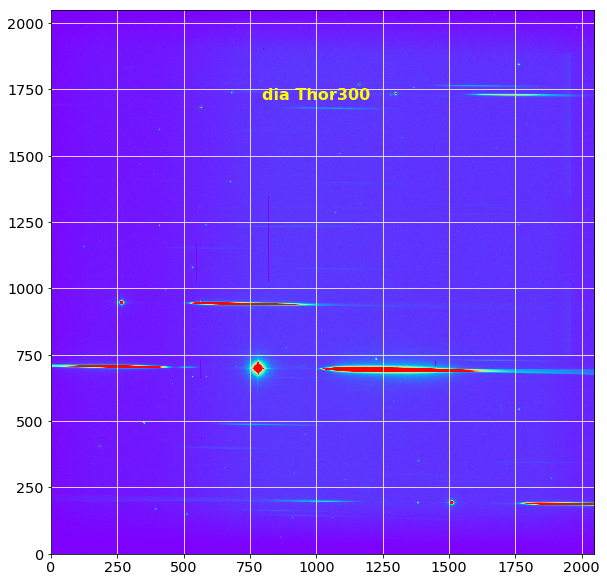

In [14]:
plt.figure(figsize=(10,10))
plt.imshow(all_images[sel_index],origin='lower',cmap='rainbow',vmin=0, vmax=2000)
plt.grid(color='white', ls='solid')
plt.text(1000.,1700,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

### Try to fit a 2D gaussian

- Fit a 2D gaussian on intensity of central star


we have to paly with the parameter below to find a common region to find the central star

In [15]:
# first rough estimate of the maximum
x0,y0=guess_init_fit(all_images[sel_index],500,1100,500,1100)

In [16]:
dw=200  # width

In [17]:
print "x0,y0=",x0,y0

x0,y0= 779 696


In [18]:
# cut the subimage
cropped_image=np.copy(all_images[sel_index][y0-dw:y0+dw,x0-dw:x0+dw])

In [19]:
NY=cropped_image.shape[0]
NX=cropped_image.shape[1]

In [20]:
# build a mesh grid of x-y
y, x = np.mgrid[:NY,:NX]

In [21]:
z=cropped_image[y,x]

### Show the pre-selected subimage

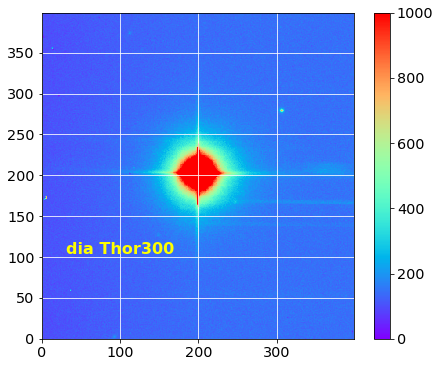

In [22]:
# plot x,y,z
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

In [23]:
x_mean=NX/2
y_mean=NY/2
z_max=z[y_mean,x_mean]
print x_mean,y_mean,z_max

200 200 61160.3778045


### Make the 2D fit

In [24]:
p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
fit_p = fitting.LevMarLSQFitter()

In [25]:
import warnings
p = fit_p(p_init, x, y, z)

In [26]:
print p.x_mean
print p.y_mean
print p.amplitude

Parameter('x_mean', value=199.85732044)
Parameter('y_mean', value=203.029303575)
Parameter('amplitude', value=80067.6991573)


In [27]:
new_x0=p.x_mean
new_y0=p.y_mean

### Show result of 2D gaussian fit

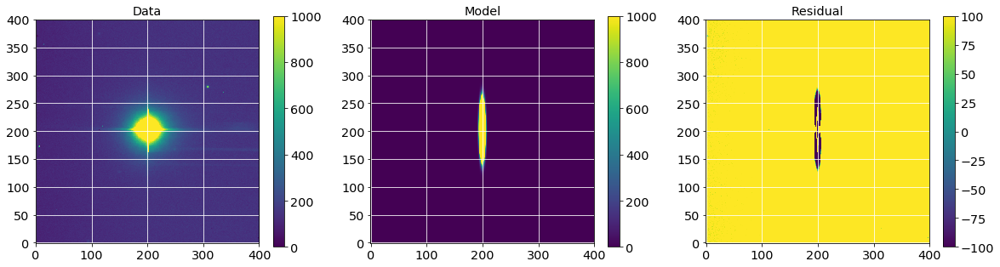

In [28]:
plt.figure(figsize=(20, 5))
#subplot 1
plt.subplot(1, 3, 1)
plt.imshow(z, origin='lower', interpolation='nearest', vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Data")
#subplot 2
plt.subplot(1, 3, 2)
plt.imshow(p(x, y), origin='lower', interpolation='nearest', vmin=0,vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Model")
#subplot 3
plt.subplot(1, 3, 3)
plt.imshow(z - p(x, y), origin='lower', interpolation='nearest', vmin=-100,vmax=100)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Residual")

### Check the result of the fit

- the center of the star is where it is expected (black point)

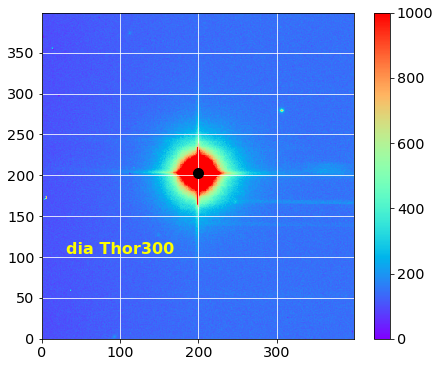

In [29]:
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.plot([new_x0],[new_y0],'ko',markersize=10)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

## Show the images at Input

- So now work on the series of the images

- First look at them
- notice there is a downsampling factor of 10

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

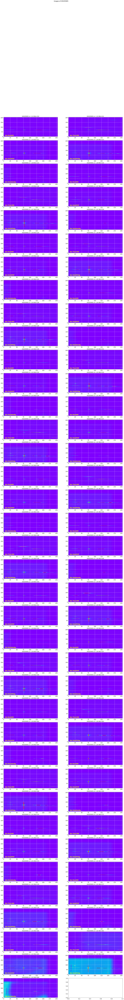

In [30]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,downsampling=10,verbose=True)

figfilename=os.path.join(dir_top_images,'input_images.pdf')
plt.savefig(figfilename)   

## Show the histograms of input images

- just check the reduction and deflattage is OK

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

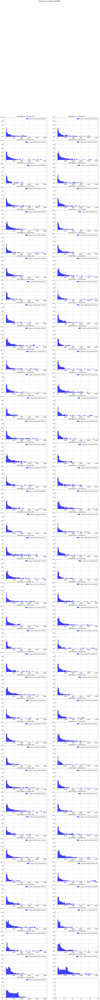

In [31]:
ShowHistograms(all_images,all_titles,all_filt,object_name,
               NBIMGPERROW=2,bins=100,range=(-50,10000),downsampling=10,verbose=True)

##  Guess central position of the central star in original image

- defines two utility functions


### Compute the position of central star

In [32]:
# guess the region where the maximum is
Delta_x0=[500,1100]
Delta_y0=[500,1100]
dwc=200

x_guess,y_guess=guess_central_position(all_images,Delta_x0,Delta_y0,dwc,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx)

0 : (x_guess,y_guess)= 777.807889586 696.982000126
1 : (x_guess,y_guess)= 778.85732044 699.029303575
2 : (x_guess,y_guess)= 778.215059413 701.924702187
3 : (x_guess,y_guess)= 779.258075176 698.807288389
4 : (x_guess,y_guess)= 778.857995478 697.190398456
5 : (x_guess,y_guess)= 778.341784863 697.648963947
6 : (x_guess,y_guess)= 778.013331378 699.126418527
7 : (x_guess,y_guess)= 778.644885139 701.054046923
8 : (x_guess,y_guess)= 779.473144967 696.725789493
9 : (x_guess,y_guess)= 779.126979127 695.81294805
10 : (x_guess,y_guess)= 778.840260839 696.046552508
11 : (x_guess,y_guess)= 778.915067046 696.315903489
12 : (x_guess,y_guess)= 779.135912676 697.969534114
13 : (x_guess,y_guess)= 779.598074238 695.245003506
14 : (x_guess,y_guess)= 778.75234403 694.183955009
15 : (x_guess,y_guess)= 779.059398084 694.352864893
16 : (x_guess,y_guess)= 779.08763508 695.185472192
17 : (x_guess,y_guess)= 777.911609604 697.464760141
18 : (x_guess,y_guess)= 778.56325576 693.441474005
19 : (x_guess,y_guess)= 778

../../common_tools/common_notebook.py:1293: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
  if filt5_idx != None and filt5_idx.shape[0] != 0:


/Users/dagoret/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


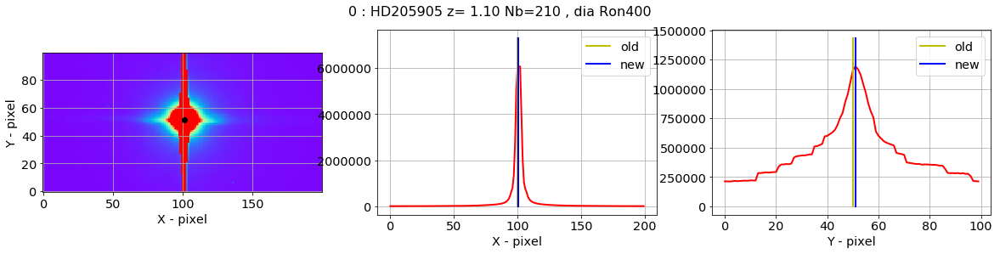

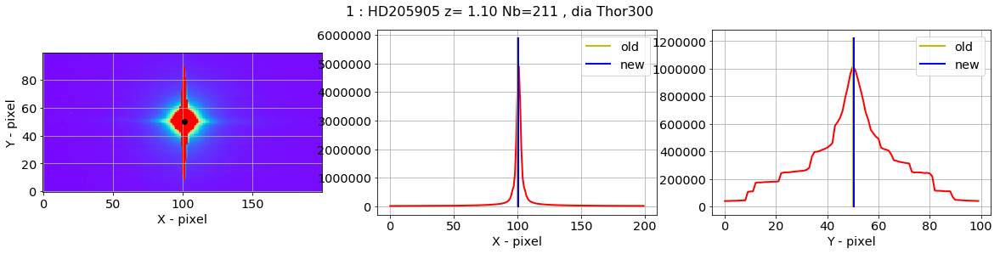

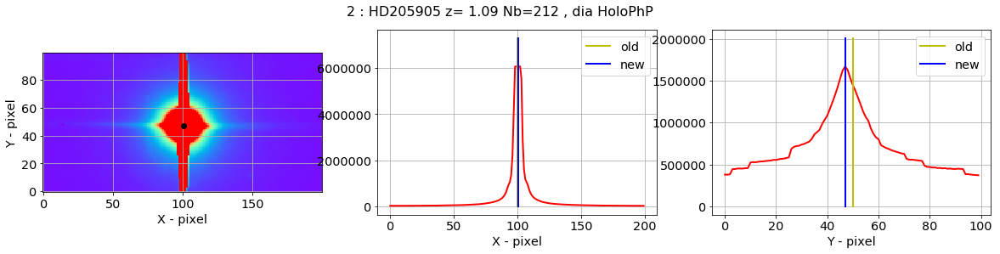

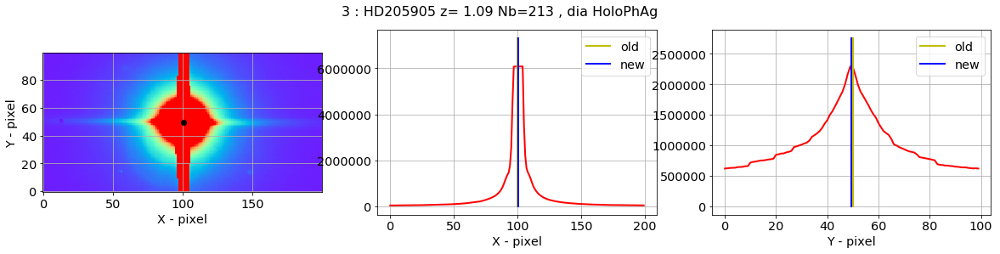

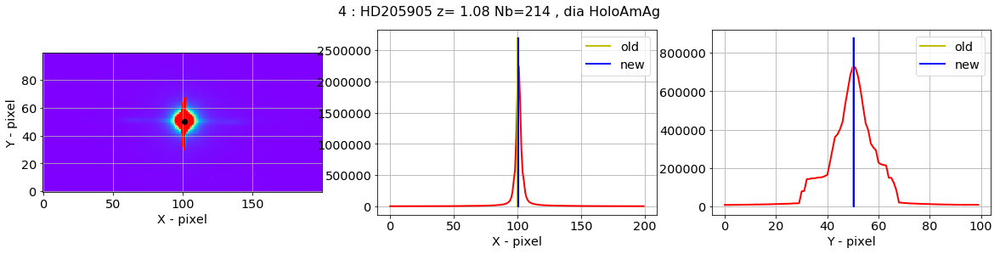

...

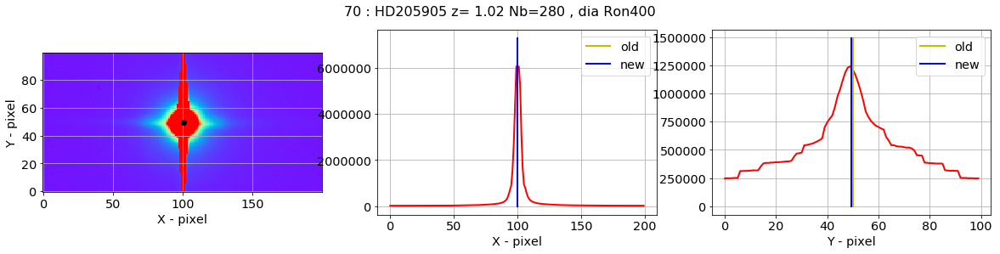

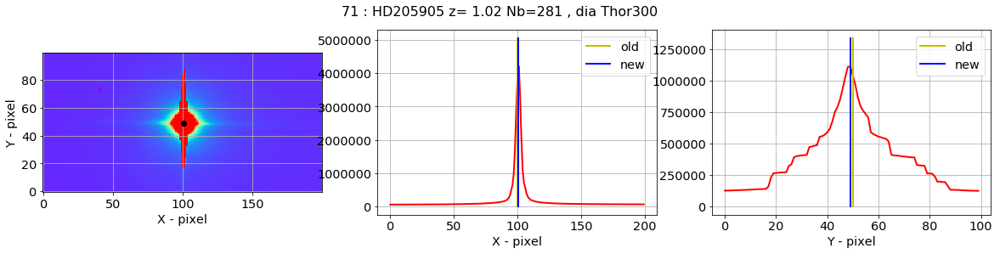

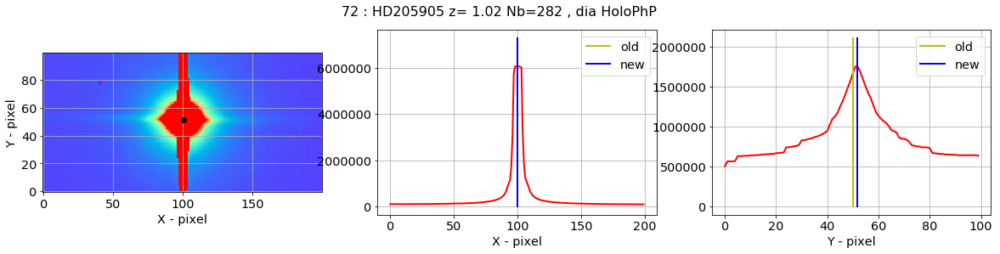

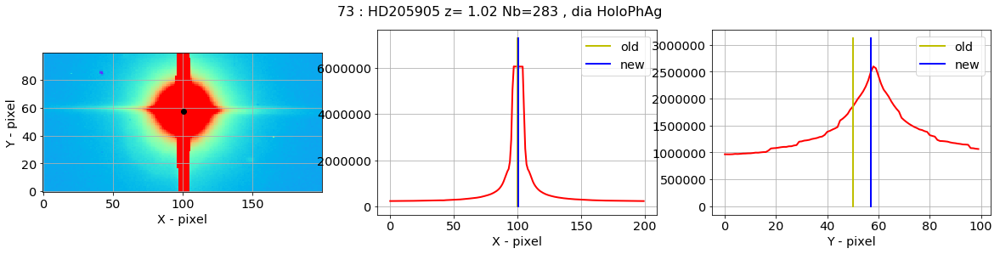

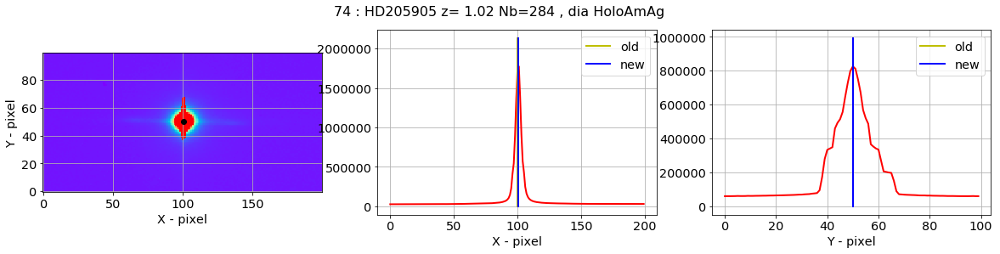

In [33]:
new_x_guess,new_y_guess=check_central_star(all_images,x_guess,y_guess,all_titles,all_filt,Dx=100,Dy=50)

### Check corrections of the center

In [34]:
dx_guess=new_x_guess-x_guess
dy_guess=new_y_guess-y_guess

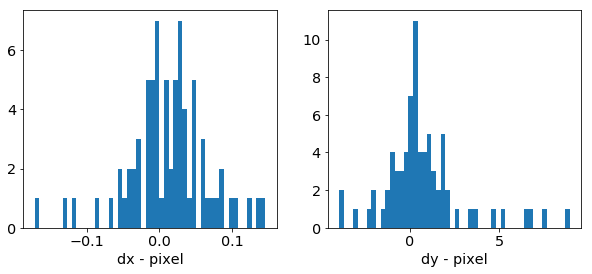

In [35]:
f, (ax1, ax2) = plt.subplots(1,2, figsize=(10,4))
ax1.hist(dx_guess,bins=50);
ax1.set_xlabel("dx - pixel")
ax2.hist(dy_guess,bins=50);
ax2.set_xlabel("dy - pixel")

In [36]:
x_guess=new_x_guess
y_guess=new_y_guess

## Save x_guess, y_guess in a file

In [37]:
ar = {'x_guess' : x_guess, 'y_guess' : y_guess}
df = pd.DataFrame(ar)

In [38]:
df.head()

,x_guess,y_guess
0,777.817052,697.213424
1,778.828008,699.389248
2,778.262882,698.021874
3,779.394803,697.262388
4,778.822621,697.404092


In [39]:
df.tail()

,x_guess,y_guess
70,752.169572,674.377769
71,751.649007,675.024070
72,751.072680,672.554510
73,750.351458,671.177215
74,748.520597,672.039066


In [40]:
df.describe()

,x_guess,y_guess
count,75.000000,75.000000
mean,769.558114,686.635858
std,9.825023,7.907522
min,748.520597,671.177215
25%,760.335971,680.064155
50%,773.613362,686.939899
75%,777.956202,693.981000
max,779.561418,699.389248


In [41]:
df.to_csv('x_y_guess.csv')

## Finally cut image

- before rotation

- cut the image around the spectra
- the width in Y is DeltaY=100 pixel above and down

In [42]:
DeltaY=[100]*len(all_images)
DeltaX=[2000]*len(all_images)  # must be very large to have correct x positions

images_raw=ShowCenterImages(x_guess,y_guess,DeltaX,DeltaY,all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000,target_pos=np.array([x_guess,y_guess]).T)
figfilename=os.path.join(dir_top_images,'cut_images.pdf')
plt.savefig(figfilename)   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


## Save cut images
------------------------

- save the series of cut images called **images_raw** in a file


In [43]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^%s_(.*)' % tag,short_infilename)
    short_outfilename='cutimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)
    
for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_raw[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)

!ls -l cut_fitsimages/*

-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 09:29 cut_fitsimages/cutimg_20170530_210.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 09:29 cut_fitsimages/cutimg_20170530_211.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 09:29 cut_fitsimages/cutimg_20170530_212.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 09:29 cut_fitsimages/cutimg_20170530_213.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 09:29 cut_fitsimages/cutimg_20170530_214.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 09:29 cut_fitsimages/cutimg_20170530_215.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 09:29 cut_fitsimages/cutimg_20170530_216.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 09:29 cut_fitsimages/cutimg_20170530_217.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 09:29 cut_fitsimages/cutimg_2

---------------------------------------------------------------------------------
# Section 2 : Find the rotation angle and apply rotation
----------------------------------------------------------------------------------

## Initialisation of Section 2
----------------------------------

In [44]:
inputdir="./cut_fitsimages"
SelectTagRe='^cutimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^cutimg_%s_[0-9]+.fits$' % date

outputdir="./rotated_fitsimages"
ensure_dir(outputdir)

sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt,all_filt1,all_filt2=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 75


In [45]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx=get_filt_idx(all_filt)

In [46]:
df=pd.read_csv('x_y_guess.csv')
x_guess=df["x_guess"]
y_guess=df["y_guess"]
DeltaY=[100]*len(all_images)

In [47]:
df.head()

,Unnamed: 0,x_guess,y_guess
0,0,777.817052,697.213424
1,1,778.828008,699.389248
2,2,778.262882,698.021874
3,3,779.394803,697.262388
4,4,778.822621,697.404092


## Find rotation by Hessian analysis

La méthode s'inspire des techniques de détection de filmanents dans le milieu interstellaire.
Elle est décrite dans https://arxiv.org/pdf/1409.6728.pdf section 4.1.
Documentation sur le calcul du Hessien : http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.hessian_matrix

### Test rotation optimal settings

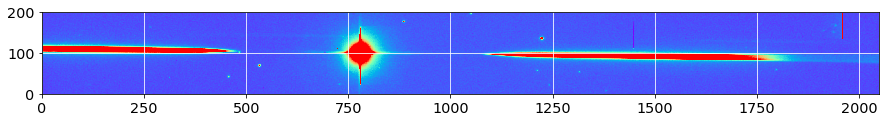

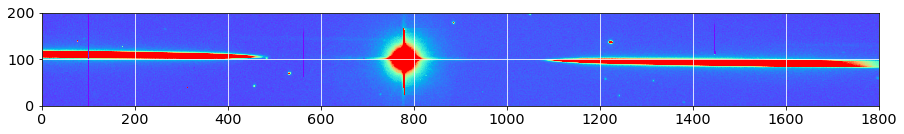

In [48]:
sel=0
image_sel=np.copy(all_images[sel])
y0=DeltaY[sel]
x0=x_guess[sel]

width_cut = 100
right_edge = 1800

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,0:right_edge])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

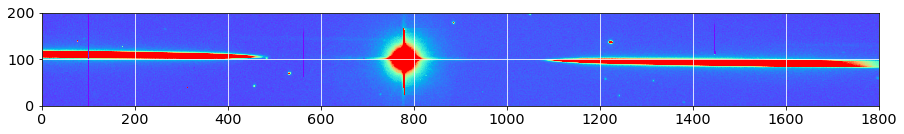

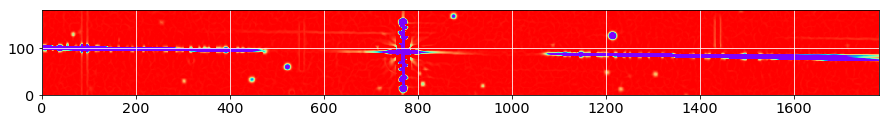

In [49]:
# le paramètre sigma permet de lisser le hessien
Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi

margin_cut = 10

lambda_minus = lambda_minus[margin_cut:-margin_cut,margin_cut:-margin_cut]
lambda_plus = lambda_plus[margin_cut:-margin_cut,margin_cut:-margin_cut]
theta = theta[margin_cut:-margin_cut,margin_cut:-margin_cut]

plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()
plt.imshow(lambda_minus,origin='lower',cmap='rainbow',vmin=-10,vmax=0)
plt.grid(color='white', ls='solid')
plt.show()

Number of remaining pixels : 16331


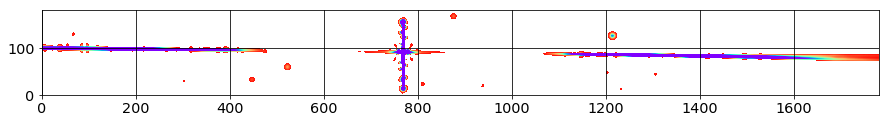

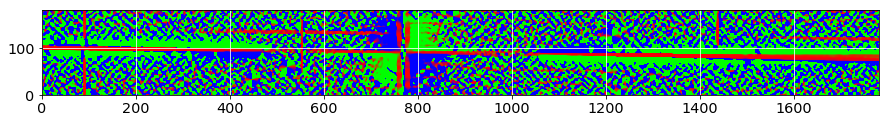

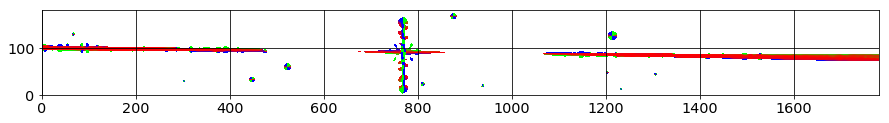

In [50]:
lambda_threshold = -2

mask = np.where(lambda_minus>lambda_threshold)
lambda_mask = np.copy(lambda_minus)
lambda_mask[mask]=np.nan

theta_mask = np.copy(theta)
theta_mask[mask]=np.nan

print 'Number of remaining pixels :',len(lambda_mask[~np.isnan(lambda_mask)])

plt.imshow(lambda_mask,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='black', ls='solid')
plt.show()

plt.imshow(theta,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='white', ls='solid')
plt.show()

plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='black', ls='solid')
plt.show()

Number of remaining pixels : 12202


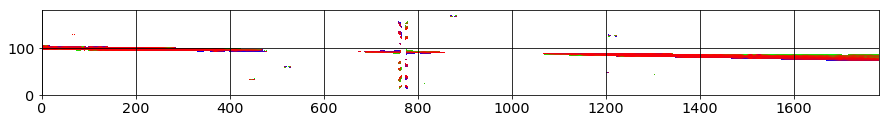

In [51]:
deg_threshold = 20

mask2 = np.where(np.abs(theta)>deg_threshold)
theta_mask[mask2] = np.nan
print 'Number of remaining pixels :',len(theta_mask[~np.isnan(theta_mask)])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.grid(color='black', ls='solid')
plt.show()

Angle median : -0.680758660134


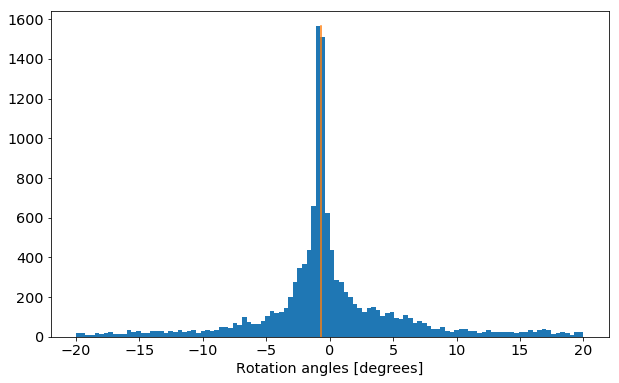

In [52]:
theta_hist = []
theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
theta_median = np.median(theta_hist)
print 'Angle median :',theta_median
fig = plt.figure(figsize=(10,6))
n,bins, patches = plt.hist(theta_hist,bins=int(np.sqrt(len(theta_hist))))
plt.plot([theta_median,theta_median],[0,np.max(n)])
plt.xlabel("Rotation angles [degrees]")
plt.show()

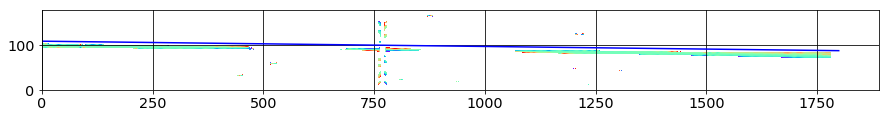

In [53]:
xindex=np.arange(data.shape[1])
x_new = np.linspace(xindex.min(),xindex.max(), 50)
#y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
# really want to see of hessian an straight line math SDC : Sept 25 2017
y_new = y0   + (x_new-x0)*np.tan(theta_median*np.pi/180.)
plt.imshow(theta_mask,origin='lower',cmap='rainbow',vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()


Rotation angle from fit : -0.668843195818


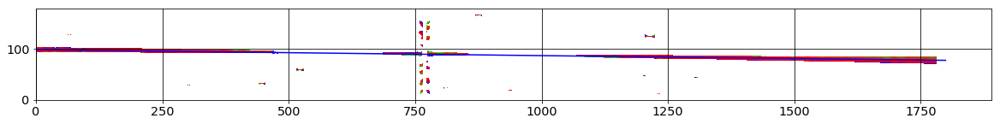

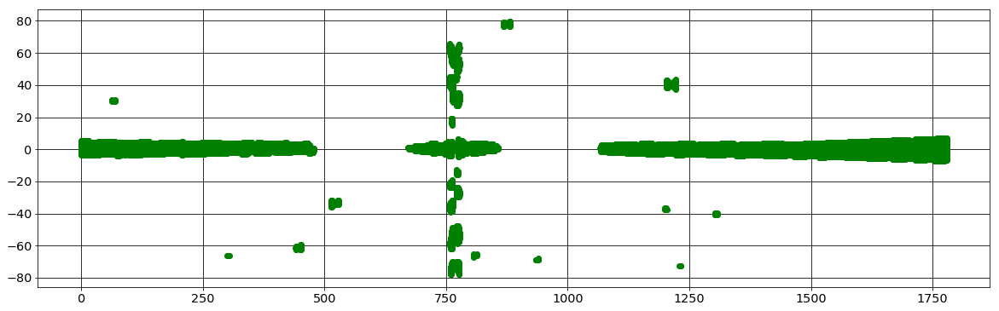

In [54]:
xtofit=[]
ytofit=[]
for iy,y in enumerate(theta_mask):
    for ix,x in enumerate(y):
        if not np.isnan(theta_mask[iy][ix]) :
            if np.abs(theta_mask[iy][ix])>deg_threshold : continue
            xtofit.append(ix)
            ytofit.append(iy)
popt, pcov = fit_line(xtofit, ytofit)
[a, b] = popt
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = line(x_new,a,b)
print 'Rotation angle from fit :',np.arctan(a)*180/np.pi
fig = plt.figure(figsize=[20,6])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()
fig = plt.figure(figsize=[20,6])
diff = []
for ix,x in enumerate(xtofit):
    diff.append(ytofit[ix]-line(x,a,b))
plt.plot(xtofit,diff,'go')
plt.grid(color='black', ls='solid')
plt.show()

Using Hessian theta angles:
0  theta =  -0.687853803054
1  theta =  -0.698754568993
2  theta =  -0.967711293477
3  theta =  -1.9015039876
4  theta =  -1.50864644948
5  theta =  -0.622673914504
6  theta =  -0.677618395769
7  theta =  -0.948875960081
8  theta =  -1.92609055165
9  theta =  -1.50637875991
10  theta =  -0.660344834643
11  theta =  -0.699644904546
12  theta =  -1.00802330834
13  theta =  -1.91543941412
14  theta =  -1.51666354669
15  theta =  -0.641645206682
16  theta =  -0.655472970442
17  theta =  -0.955996551871
18  theta =  -1.92999719688
19  theta =  -1.52924611032
20  theta =  -0.674212007659
21  theta =  -0.702590489979
22  theta =  -0.985110329895
23  theta =  -1.91915826936
24  theta =  -1.5427595178
25  theta =  -0.653623348313
26  theta =  -0.681792148013
27  theta =  -0.974404084249
28  theta =  -1.93608078345
29  theta =  -1.54664898229
30  theta =  -0.661020790375
31  theta =  -0.579582481307
32  theta =  -0.976063056968
33  theta =  -1.95322000195
34  theta = 

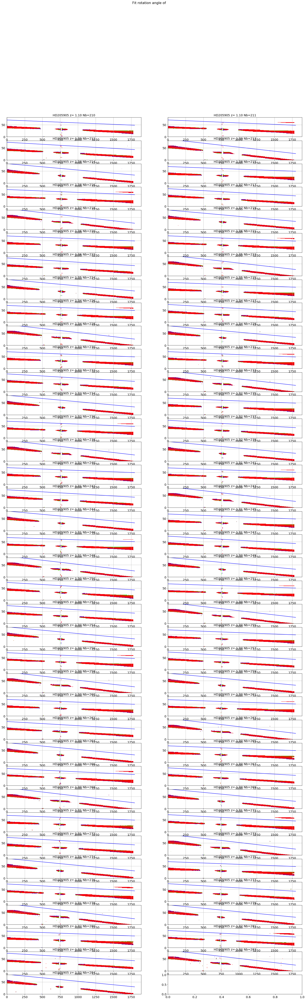

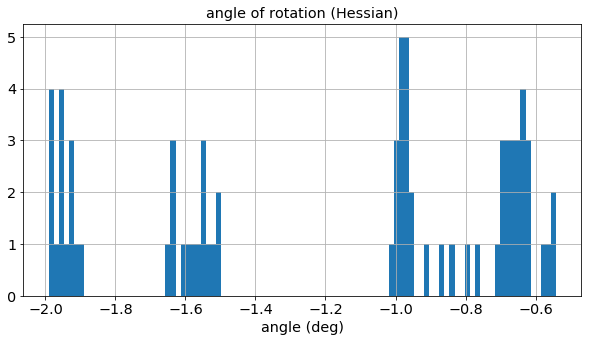

In [55]:
print 'Using Hessian theta angles:'

all_theta=ComputeRotationAngleHessian(all_images,x_guess,DeltaY,all_titles,object_name, 
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 40, right_edge = 1800, margin_cut = 10)
figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
plt.savefig(figfilename)  

for index in range(len(all_theta)):
    print index,' theta = ',all_theta[index]
plt.figure(figsize=(10,5))
n, bins, patches=plt.hist(all_theta,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation (Hessian)')
plt.xlabel('angle (deg)')

## Turn the images accordingly

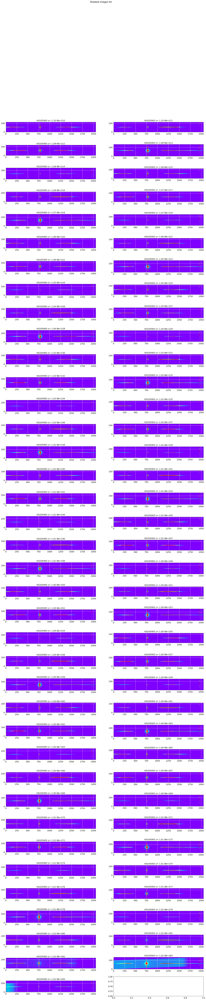

In [56]:
turned_images=TurnTheImages(all_images,all_theta,all_titles,object_name,
                            NBIMGPERROW=2,vmin=500,vmax=10000,oversample_factor=1)
figfilename=os.path.join(dir_top_images,'rotated_images.pdf')
plt.savefig(figfilename)  

## Check rotations

array([-0.03675939,  0.03009498,  0.025664  ,  0.00901259,  0.04281208,
       -0.02941545,  0.02796054,  0.0220628 ,  0.03548289,  0.05186038,
       -0.00818738,  0.03147359,  0.03847541,  0.00804256,  0.06095154,
       -0.00917971,  0.00531335,  0.0315468 , -0.00715165,  0.06489251,
       -0.00115961, -0.00315825,  0.03303971, -0.00206673,  0.05525957,
       -0.00434321,  0.01187017,  0.03003553,  0.02475012,  0.06778638,
       -0.01305947,  0.01460294,  0.01204153,  0.00487201,  0.03228804,
       -0.00839592, -0.00363788,  0.03017607,  0.04196989,  0.03652293,
       -0.00480058,  0.01978525,  0.0385721 ,  0.00762014,  0.03933184,
       -0.0113753 , -0.00197765,  0.0284977 ,  0.01944812,  0.04400329,
       -0.00610529,  0.00733788,  0.04403571,  0.01720011,  0.0345314 ,
       -0.0454437 ,  0.01794449,  0.06344411,  0.03020871,  0.04819321,
       -0.02875608,  0.0086474 ,  0.04737544,  0.01662595,  0.05046197,
       -0.01019653,  0.00233667,  0.04349999,  0.00755123,  0.03

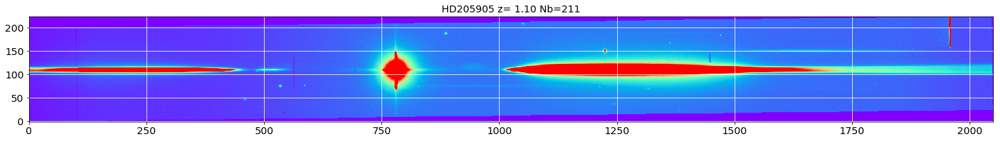

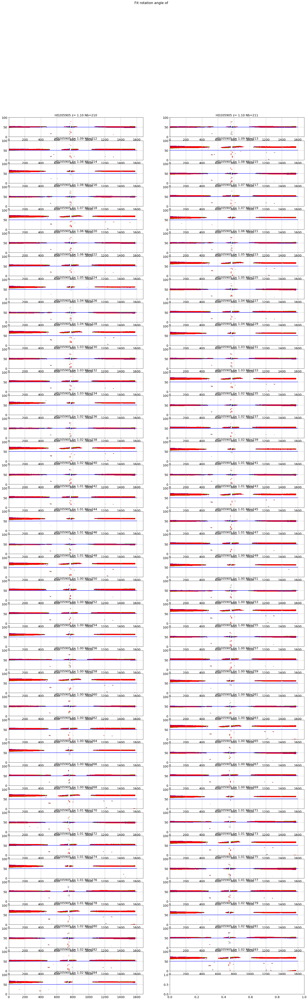

In [57]:
sel=1
plt.figure(figsize=(25,10))
plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
plt.grid(True)
plt.title(all_titles[sel])
plt.grid(color='white', ls='solid')
figfilename=os.path.join(dir_top_images,'rotated_image_sample.pdf')
plt.savefig(figfilename)  

ComputeRotationAngleHessian(turned_images,x_guess,DeltaY,all_titles,object_name,
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 50, right_edge = 1600, margin_cut = 10)

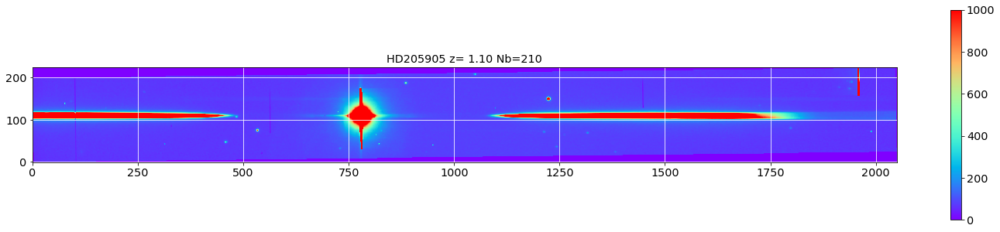

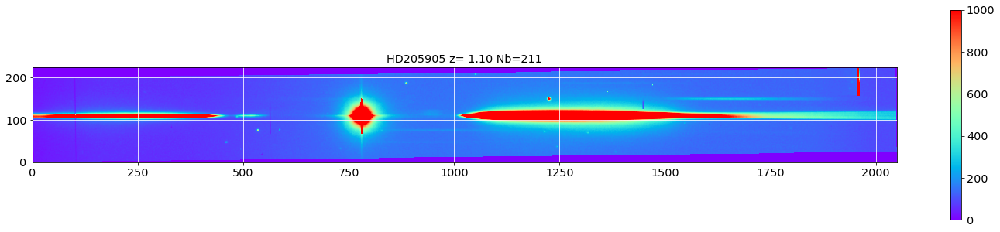

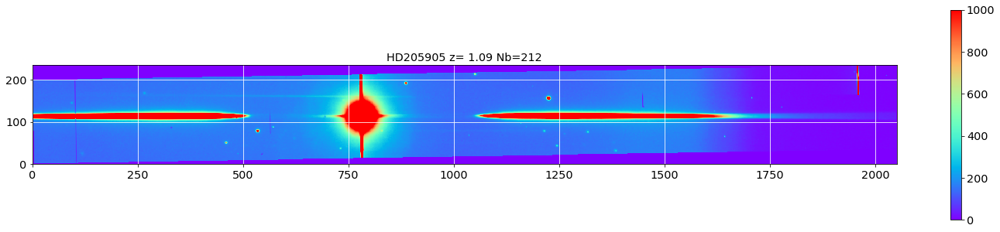

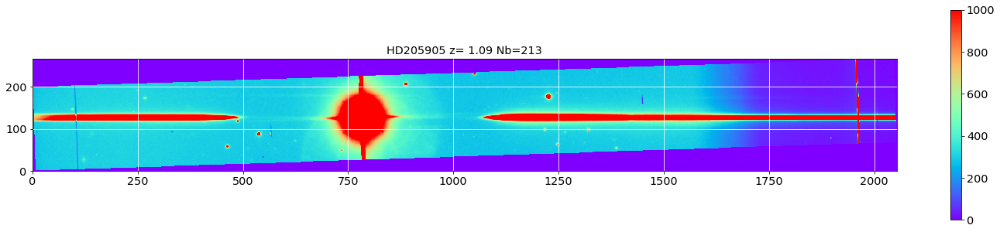

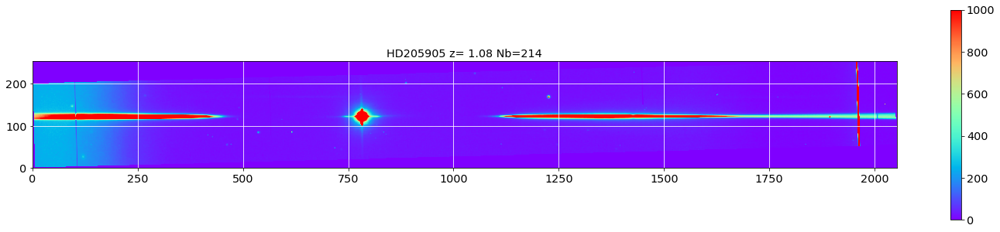

...

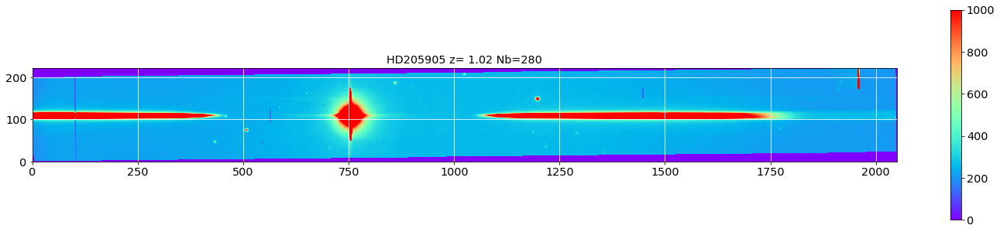

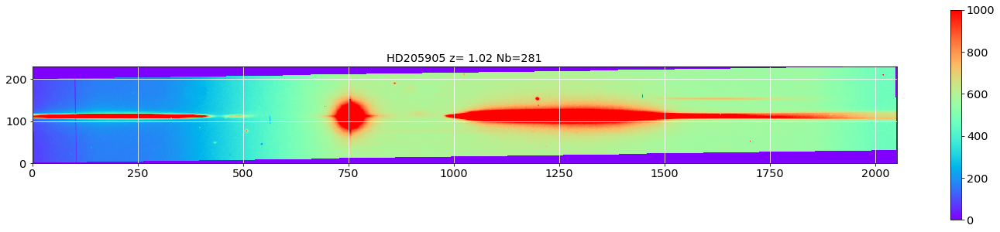

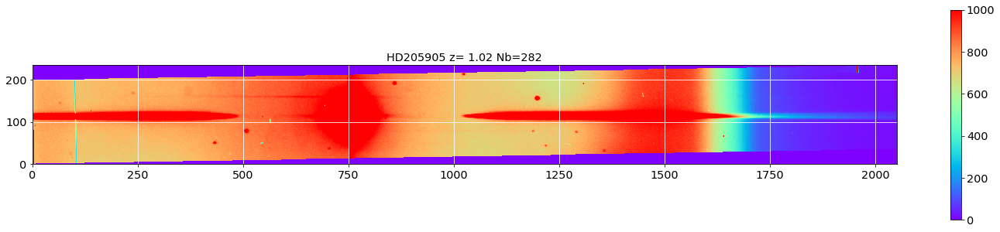

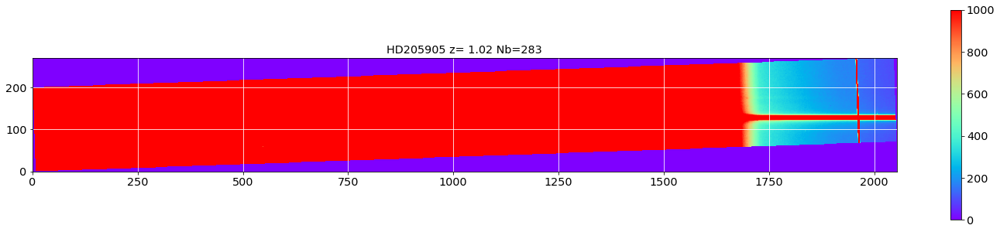

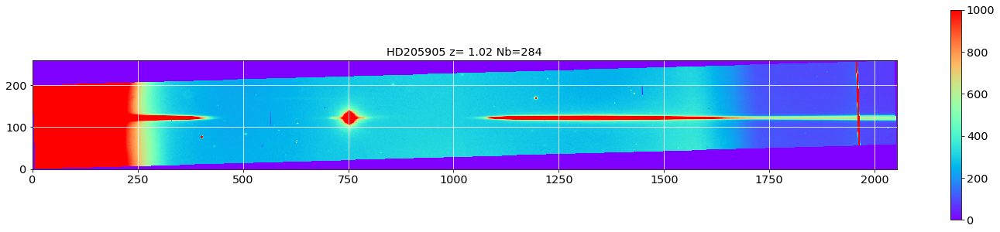

In [58]:
debug=True
if debug:
    for sel in range(len(turned_images)):
        plt.figure(figsize=(25,5))
        plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
        plt.grid(True)
        plt.title(all_titles[sel])
        plt.grid(color='white', ls='solid')
        plt.colorbar()

## Must guess again the new centers for rotation

In [59]:
# guess the region where the maximum is
Delta_x02=[500,1100]
Delta_y02=[50,150]
dwc2=40

In [60]:
turned_images[0].shape

(225, 2050)

In [61]:
guess_init_fit(turned_images[0],Delta_x02[0],Delta_x02[1],Delta_y02[0],Delta_y02[1])

(779, 110)

### Initial guess

In [62]:
x_guess2,y_guess2=guess_central_position(turned_images,Delta_x02,Delta_y02,dwc2,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx)

0 : (x_guess,y_guess)= 778.816092433 109.645683888
1 : (x_guess,y_guess)= 779.869512178 109.669441803
2 : (x_guess,y_guess)= 779.778150631 112.083674886
3 : (x_guess,y_guess)= 782.476007298 125.054131038
4 : (x_guess,y_guess)= 781.430682577 120.784513942
5 : (x_guess,y_guess)= 779.322987168 109.116577735
6 : (x_guess,y_guess)= 779.022361068 109.57858852
7 : (x_guess,y_guess)= 780.256575422 112.315495611
8 : (x_guess,y_guess)= 782.67036993 125.729398252
9 : (x_guess,y_guess)= 781.702198427 120.404668367
10 : (x_guess,y_guess)= 779.8177973 109.77405595
11 : (x_guess,y_guess)= 779.936447711 108.987284457
12 : (x_guess,y_guess)= 780.681162674 114.176232773
13 : (x_guess,y_guess)= 782.821586441 125.063803831
14 : (x_guess,y_guess)= 781.318808016 120.754305888
15 : (x_guess,y_guess)= 780.05955801 109.610239378
16 : (x_guess,y_guess)= 780.107801147 107.931851428
17 : (x_guess,y_guess)= 779.429192416 112.169334853
18 : (x_guess,y_guess)= 781.749713657 125.799875628
19 : (x_guess,y_guess)= 780.

### Check new guess of turned images

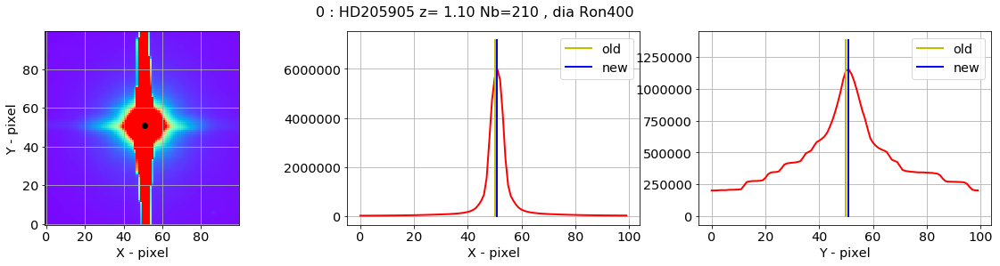

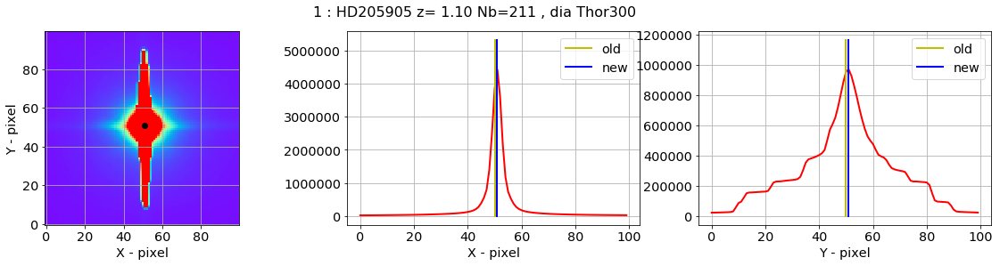

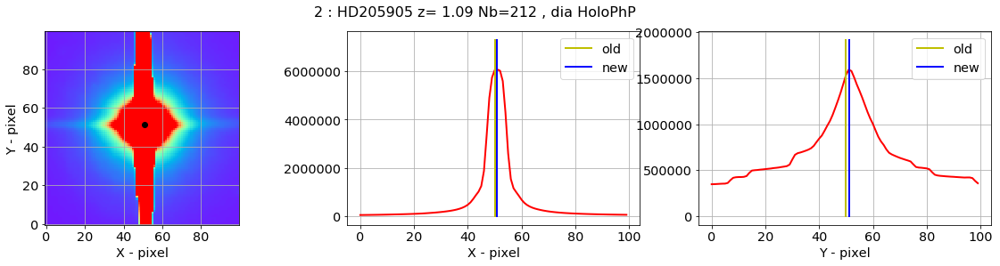

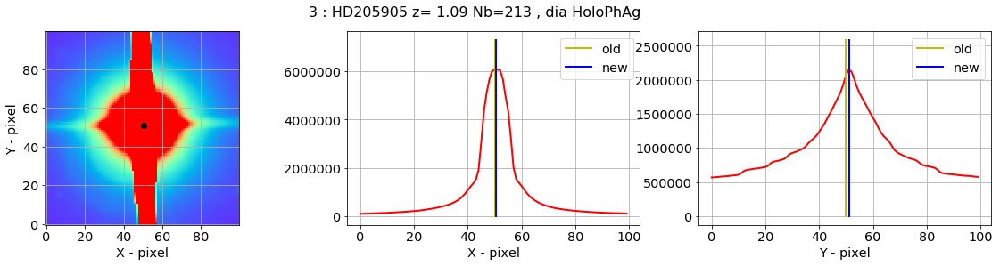

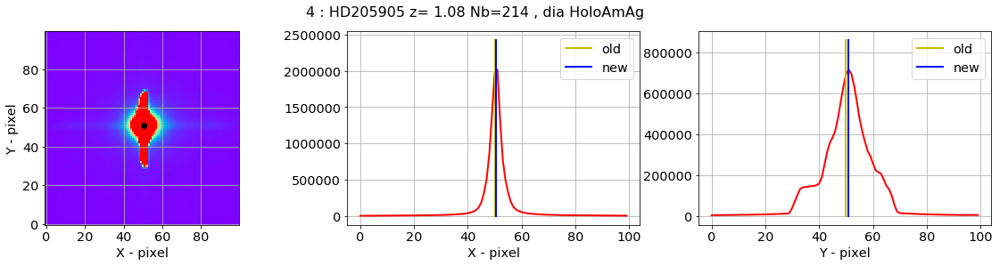

...

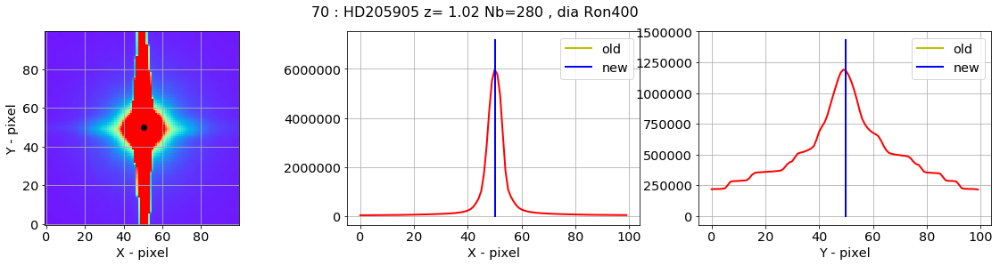

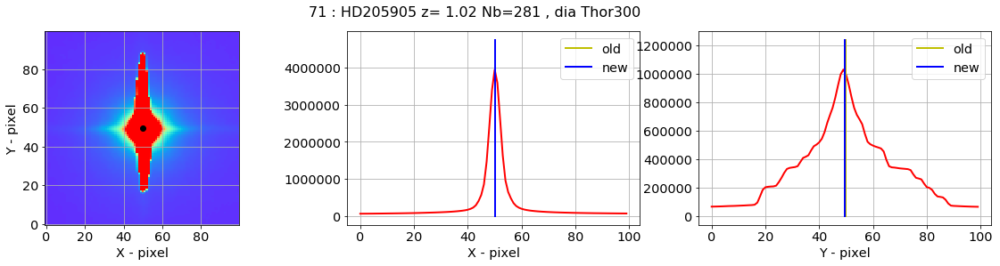

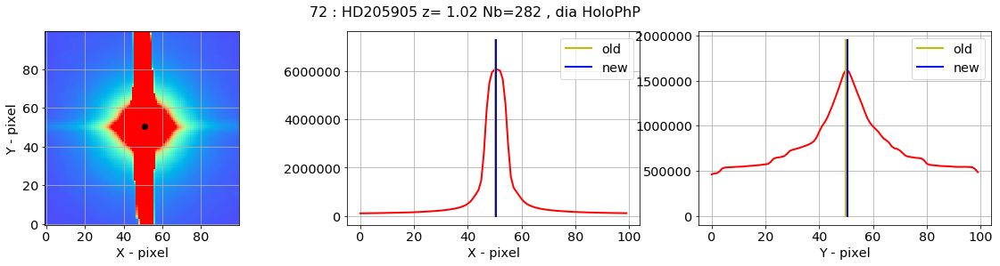

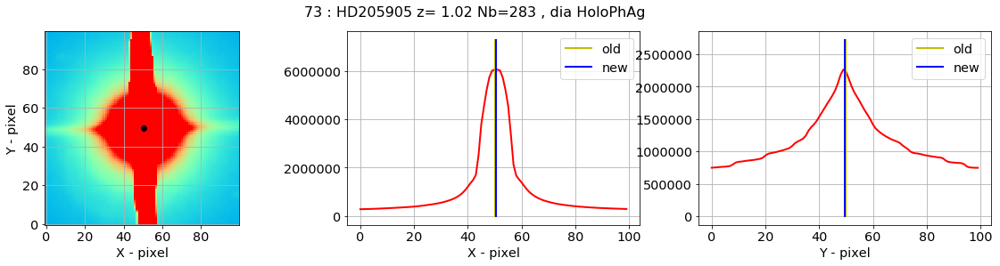

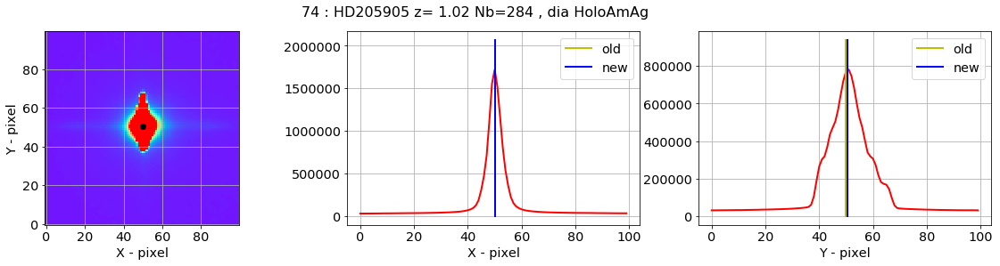

In [63]:
new_x_guess2,new_y_guess2=check_central_star(turned_images,x_guess2,y_guess2,all_titles,all_filt,Dx=50,Dy=50)

In [64]:
x_guess2=new_x_guess2
y_guess2=new_y_guess2

In [65]:
ar2 = {'x_guess2' :x_guess2, 'y_guess2' : y_guess2,'theta' :all_theta}
df2 = pd.DataFrame(ar2)

In [66]:
df2.head()

,theta,x_guess2,y_guess2
0,-0.687854,778.843565,109.762935
1,-0.698755,779.889708,109.911530
2,-0.967711,779.820360,113.275892
3,-1.901504,782.513463,126.080753
4,-1.508646,781.477620,120.969250


In [67]:
df2.to_csv('x_y_guess2.csv')

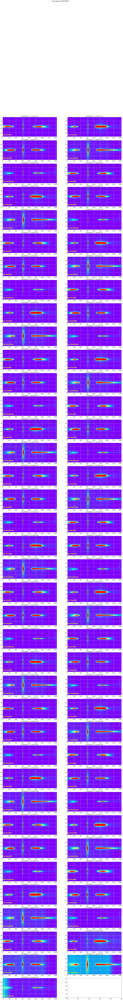

In [68]:
DeltaX=[2000]*len(all_images)
DeltaY_rot2 = [50]*len(all_images) # change from 20 to 50 to see well the central star
x_guess_rot2 = x_guess2
y_guess_rot2 = y_guess2
images_cut_rot=ShowCenterImages(x_guess_rot2,y_guess_rot2,DeltaX,DeltaY_rot2,
                    turned_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,target_pos=np.array([x_guess2,y_guess2]).T) 

## Find the central star locations
======================================

### Central star positions after rotation and cut

In [69]:
# Not necessary to do this because already done
CompareBeforeAfterRotFlag=False

if CompareBeforeAfterRotFlag:

    x_guess_rot = x_guess2
    y_guess_rot = y_guess2
    DeltaY_rot = [100]*len(all_images)
    DeltaX_rot = [100]*len(all_images)
    # First stage : show the rotated images which were cut
    print 'First stage : show the rotated images which were cut'
    #--------------------------------------------------------------
    images_cut=ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,
                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,target_pos=np.array([x_guess2,y_guess2]).T) 
    # Second stage : show the images cut before they were cut
    print 'Second stage : show the images cut before they were cut'
    #----------------------------------------------------------------
    images_cut_before_rot=ShowCenterImages(x_guess,[100]*len(all_images),DeltaX_rot,DeltaY_rot,
                    all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,target_pos=np.array([x_guess,y_guess]).T) 

In [70]:
# DAOFind does not work for me (never)
DAOFindUseFlag=False
    
# (JN) valeurs optimisées pour cette étude
if DAOFindUseFlag:
    img_mean,img_median,img_std,img_sources=ComputeStatImages(images_cut,fwhm=10,threshold=10,sigma=5.0,iters=5)
    print 'total number of images',len(images_cut)
    print 'number of centroid found ',len(img_sources)

## Central star position

- should take the brightest

In [71]:
if DAOFindUseFlag:
    x_star = []
    y_star = []
    for index,s in enumerate(img_sources):
        for ss in s:
            x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
            y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
    x_mean = np.mean(x_star)
    y_mean = np.mean(y_star)
    img_size=all_images[0].shape
    plt.figure(figsize=(5,5))

    # plot individual image center
    plt.plot(x_star,y_star,'o')
    # plot the average postion
    plt.plot(x_mean,y_mean,'ro')
    plt.xlim(0,img_size[1])
    plt.ylim(0,img_size[0])
    plt.grid(True)
    
    print 'nuber of x_star = ',len(x_star)
    print 'nuber of y_star = ',len(y_star)

> The problem is that DAOFIND may not find a center for each source. Thys the only solution
is to do the same thing : computing the average depending on each filter.

In [72]:
if DAOFindUseFlag:
    x_star = []
    y_star = []

    x_star_f0 = []
    y_star_f0 = []

    x_star_f1 = []
    y_star_f1 = []

    x_star_f2 = []
    y_star_f2 = []

    x_star_f3 = []
    y_star_f3 = []

    x_star_f4 = []
    y_star_f4 = []

    missing_centroid = []
    missing_centroid_f0 = []
    missing_centroid_f1 = []
    missing_centroid_f2 = []
    missing_centroid_f3 = []
    missing_centroid_f4 = []


    # loop on all image- source
    for index,s in enumerate(img_sources):
        print "star number :",index
        if len(s) == 0:
            print '!! found no centroid'
            missing_centroid.append(index)
        
            if index in filt0_idx:
                missing_centroid_f0.append(index)
        
            if index in filt1_idx:
                missing_centroid_f1.append(index)
            
            if index in filt2_idx:
                missing_centroid_f2.append(index)   
            
            if index in filt3_idx:
                missing_centroid_f3.append(index)     

            if index in filt4_idx:
                missing_centroid_f4.append(index) 
            
        else:
            print 'found ',len(s),' centroid '
            # loop on individual sources in the image
            for ss in s:
                x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
                if index in filt0_idx:
                    x_star_f0.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f0.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
                if index in filt1_idx:
                    x_star_f1.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f1.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
                if index in filt2_idx:
                    x_star_f2.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f2.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
                
                if index in filt3_idx:
                    x_star_f3.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f3.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])            

                if index in filt4_idx:
                    x_star_f4.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f4.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])        
        
    x_mean = np.mean(x_star)
    y_mean = np.mean(y_star)

    x0_mean = np.mean(x_star_f0)
    y0_mean = np.mean(y_star_f0)



    x1_mean = np.mean(x_star_f1)
    y1_mean = np.mean(y_star_f1)

    x2_mean = np.mean(x_star_f2)
    y2_mean = np.mean(y_star_f2)

    x3_mean = np.mean(x_star_f3)
    y3_mean = np.mean(y_star_f3)

    x4_mean = np.mean(x_star_f4)
    y4_mean = np.mean(y_star_f4)

    print 'SUMMARY ::'
    print '=========='

    print '\t - Found ', len(x_star_f0), ' for filters ',filt_names[0]
    print '\t - Found ', len(x_star_f1), ' for filters ',filt_names[1]
    print '\t - Found ', len(x_star_f2), ' for filters ',filt_names[2]
    print '\t - Found ', len(x_star_f3), ' for filters ',filt_names[3]
    print '\t - Found ', len(x_star_f4), ' for filters ',filt_names[4]

    print '\t - Missing centroids for indexes', missing_centroid
    print '\t - Missing centroids for filter ',filt_names[0], ' : idx = ',missing_centroid_f0
    print '\t - Missing centroids for filter ',filt_names[1], ' : idx = ',missing_centroid_f1
    print '\t - Missing centroids for filter ',filt_names[2], ' : idx = ',missing_centroid_f2
    print '\t - Missing centroids for filter ',filt_names[3], ' : idx = ',missing_centroid_f3
    print '\t - Missing centroids for filter ',filt_names[4], ' : idx = ',missing_centroid_f4

    img_size=all_images[0].shape
    plt.figure(figsize=(15,5))

    # plot individual image center

    # plot the average postion
    plt.plot(x_mean,y_mean,'ro',label='average position')




    plt.plot(x_star_f1,y_star_f1,marker='o',color='lightgreen',label=filt_names[0],lw=0)
    plt.plot(x_star_f2,y_star_f2,marker='o',color='cyan',label=filt_names[1],lw=0)
    plt.plot(x_star_f3,y_star_f3,marker='o',color='orange',label=filt_names[2],lw=0)
    plt.plot(x_star_f4,y_star_f4,marker='o',color='yellow',label=filt_names[3],lw=0)
    plt.plot(x_star_f4,y_star_f0,marker='o',color='magenta',label=filt_names[0],lw=0)

    plt.plot(x_star,y_star,'k+')

    plt.xlim(0,img_size[1])
    #plt.ylim(0,img_size[0])
    plt.ylim(0,200)
    plt.grid(True)
    plt.legend()




### Given DAOFind can find 0 center or more than one, I prefer my guess with a gaussian fit

In [73]:
# Not done because my initial guess is much better
#tmp = ShowCenterImages(x_star,y_star,DeltaX_rot,DeltaY_rot,
#                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

In [74]:
if DAOFindUseFlag:
    tmp = ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

### Zero order positions before rotations

In [75]:
if DAOFindUseFlag:
    DeltaY_rot = [50]*len(all_images)
    DeltaX_rot = [50]*len(all_images)
    y_guess2 = DeltaY
    images_raw_cut=ShowCenterImages(x_guess,y_guess2,DeltaX_rot,DeltaY_rot,
                    images_raw,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 

In [76]:
# (JN) valeurs optimisées pour cette étude
if DAOFindUseFlag:
    img_mean,img_median,img_std,img_sources=ComputeStatImages(images_raw_cut,fwhm=7,threshold=10,sigma=10.0,iters=5)

###  Finally the guess in the Section 1 was very good

- Take the determination of original position from section 1 
- Do not use DAOFind peak selection used for Photometry

[[ 777.81705164  697.21342393]
 [ 778.82800845  699.38924782]
 [ 778.26288247  698.02187365]
 [ 779.39480316  697.2623876 ]
 [ 778.8226214   697.40409152]
 [ 778.34328085  697.68169365]
 [ 778.00488188  699.08234706]
 [ 778.6726721   697.08807346]
 [ 779.50139254  696.17252547]
 [ 779.16398848  696.20630507]
 [ 778.85216738  696.28802363]
 [ 778.90523855  697.19575542]
 [ 779.12812804  695.59871758]
 [ 779.56141801  695.13081523]
 [ 778.77721486  694.79275611]
 [ 779.05048985  694.77507193]
 [ 779.09860103  696.00024978]
 [ 777.90752278  694.28368847]
 [ 778.53583208  693.59308668]
 [ 778.10357671  693.67831222]
 [ 777.41369844  693.31903894]
 [ 777.55654182  694.9461346 ]
 [ 777.74811755  692.75457956]
 [ 779.05858785  691.80564633]
 [ 777.83230901  691.11206723]
 [ 776.99490592  690.66819462]
 [ 777.17200487  691.3799463 ]
 [ 776.81676854  690.23095317]
 [ 777.85164857  689.45628916]
 [ 777.27594676  689.51393779]
 [ 777.41561836  689.11302513]
 [ 777.43873785  689.64720819]
 [ 776.1

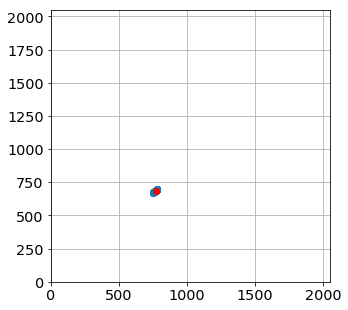

In [78]:
x_pointing = []
y_pointing = []
#for index,s in enumerate(img_sources):
for index in np.arange(len(all_images)):    
    #for ss in s:
    #    x_pointing.append(ss['xcentroid']+x_guess[index]-DeltaX_rot[index])
    #    y_pointing.append(ss['ycentroid']+y_guess[index]-DeltaY_rot[index])
    x_pointing.append(x_guess[index])
    y_pointing.append(y_guess[index])
    
        
x_mean = np.mean(x_pointing)
y_mean = np.mean(y_pointing)
img_size=all_images[0].shape
order0_positions = np.array([x_pointing,y_pointing]).T
print order0_positions

plt.figure(figsize=(5,5))
plt.plot(order0_positions.T[0],order0_positions.T[1],'o')
plt.plot(x_mean,y_mean,'ro')
plt.xlim(0,IMSIZE)
plt.ylim(0,IMSIZE)
plt.grid(True)

#####  cherche le nom de l'hologramme

In [79]:
print all_filt

['dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400

In [80]:
all_grat = []
for f in all_filt :
    #all_grat.append(f.replace('RG715 ',''))
    all_grat.append(f.replace('dia ',''))
for index,g in enumerate(all_grat):
    holo = Hologram(g,verbose=False)
    print g,holo.theta(order0_positions[index]), all_theta[index]

Ron400 -0.277 -0.687853803054
Thor300 -0.575 -0.698754568993
HoloPhP [-0.93769755] -0.967711293477
HoloPhAg [-1.52399032] -1.9015039876
HoloAmAg [-1.54910966] -1.50864644948
Ron400 -0.277 -0.622673914504
Thor300 -0.575 -0.677618395769
HoloPhP [-0.93906691] -0.948875960081
HoloPhAg [-1.52676425] -1.92609055165
HoloAmAg [-1.55366661] -1.50637875991
Ron400 -0.277 -0.660344834643
Thor300 -0.575 -0.699644904546
HoloPhP [-0.94099167] -1.00802330834
HoloPhAg [-1.52937425] -1.91543941412
HoloAmAg [-1.55835719] -1.51666354669
Ron400 -0.277 -0.641645206682
Thor300 -0.575 -0.655472970442
HoloPhP [-0.94072849] -0.955996551871
HoloPhAg [-1.53214917] -1.92999719688
HoloAmAg [-1.56175103] -1.52924611032
Ron400 -0.277 -0.674212007659
Thor300 -0.575 -0.702590489979
HoloPhP [-0.94195649] -0.985110329895
HoloPhAg [-1.53704068] -1.91915826936
HoloAmAg [-1.570671] -1.5427595178
Ron400 -0.277 -0.653623348313
Thor300 -0.575 -0.681792148013
HoloPhP [-0.94321627] -0.974404084249
HoloPhAg [-1.54167121] -1.93608

## Save results on rotated images

- Save the cut images after rotation
- Save also info on the position

In [81]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^cutimg_(.*)',short_infilename)
    short_outfilename='rotimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)

for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_cut_rot[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)
textfilename=os.path.join(outputdir,'star_centroids.txt')
print textfilename
np.savetxt(textfilename,order0_positions,header="y_star x_star",fmt='%d')

!ls -l rotated_fitsimages

./rotated_fitsimages/star_centroids.txt
total 241808
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 09:33 rotimg_20170530_210.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 09:33 rotimg_20170530_211.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 09:33 rotimg_20170530_212.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 09:33 rotimg_20170530_213.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 09:33 rotimg_20170530_214.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 09:33 rotimg_20170530_215.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 09:33 rotimg_20170530_216.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 09:33 rotimg_20170530_217.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 09:33 rotimg_20170530_218.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  

In [82]:
ar3 = {'x_pointing' :x_pointing, 'y_pointing' : y_pointing,'theta' :all_theta}
df3 = pd.DataFrame(ar3)

In [83]:
df3.to_csv('xy_pointing.csv')

In [84]:
df3

,theta,x_pointing,y_pointing
0,-0.687854,777.817052,697.213424
1,-0.698755,778.828008,699.389248
2,-0.967711,778.262882,698.021874
3,-1.901504,779.394803,697.262388
4,-1.508646,778.822621,697.404092
5,-0.622674,778.343281,697.681694
6,-0.677618,778.004882,699.082347
7,-0.948876,778.672672,697.088073
8,-1.926091,779.501393,696.172525
9,-1.506379,779.163988,696.206305


## End of Section 2 on rotation

- The following section will be removed.

- At this stage it is recommended to go to **Ana2DShapeSpectra** notebook

-------------------------------------------------------
# Section 3 : Extract spectra
---------------------------------------------------------

## Initialisation of Section 3

In [85]:
outputdir="./spectrum_fitsspec"
ensure_dir(outputdir)

inputdir="./rotated_fitsimages"
SelectTagRe='^rotimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^rotimg_%s_[0-9]+.fits$' % date

### Get coordinate of order zero before rotation

In [86]:
df=pd.read_csv('xy_pointing.csv')

In [87]:
df.head()

,Unnamed: 0,theta,x_pointing,y_pointing
0,0,-0.687854,777.817052,697.213424
1,1,-0.698755,778.828008,699.389248
2,2,-0.967711,778.262882,698.021874
3,3,-1.901504,779.394803,697.262388
4,4,-1.508646,778.822621,697.404092


In [88]:
x_star=df["x_pointing"]
y_star=df["y_pointing"]

### Get coordinate of order zero after cut and rotation (in file)

In [89]:
df2=pd.read_csv('x_y_guess2.csv')

In [90]:
df2.head()

,Unnamed: 0,theta,x_guess2,y_guess2
0,0,-0.687854,778.843565,109.762935
1,1,-0.698755,779.889708,109.911530
2,2,-0.967711,779.820360,113.275892
3,3,-1.901504,782.513463,126.080753
4,4,-1.508646,781.477620,120.969250


In [91]:
x_star2=df2["x_guess2"]
y_star2=df2["y_guess2"]

In [92]:
sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt,all_filt1,all_filt2=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 75


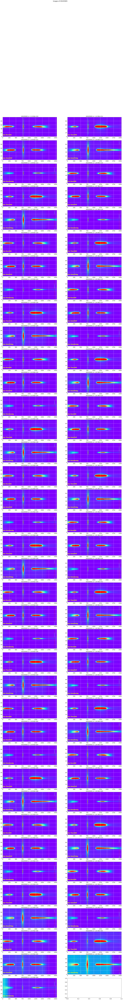

In [93]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)

## Extraction of the spectrum from the 2D - Images


### Check the transverse spectrum does not show multi-bum

This proves the rotation may be OK

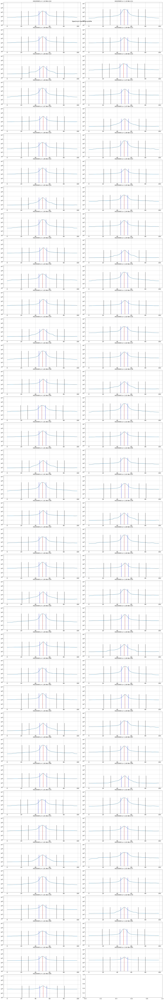

In [94]:
they0=ShowTransverseProfile(all_images,all_titles,object_name,all_expo,NBIMGPERROW=2,
                      DeltaX=1000,w=5,ws=[20,30],right_edge=1800,ylim=(1e2,2e7))

## Extract the longitudinal spectrum with its lateral bands

In [95]:
thespectra,thespectraUp,thespectraDown=ExtractSpectra(they0,all_images,all_titles,object_name,all_expo,
                                                      w=3,ws=[10,30],right_edge=1800)

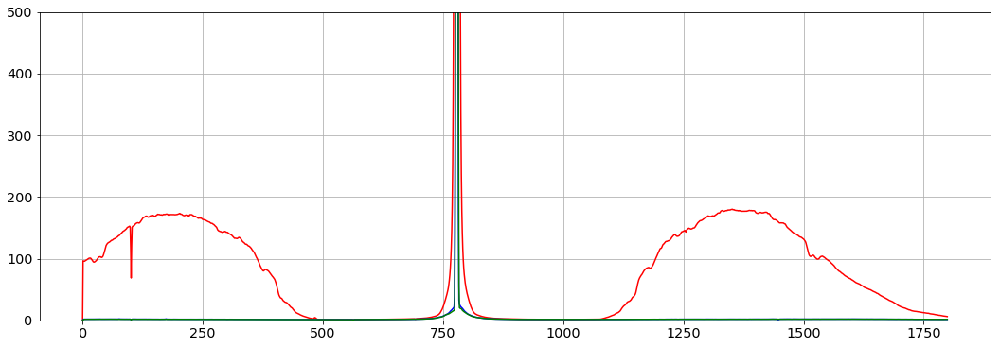

In [96]:
sel=0
plt.figure(figsize=(18,6))
plt.plot(thespectra[sel],'r-') 
plt.plot(thespectraUp[sel],'b-') 
plt.plot(thespectraDown[sel],'g-')
#plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,500.)
figfilename=os.path.join(dir_top_images,'bckg_sample.pdf')
plt.savefig(figfilename) 

In [97]:
thespectraAv=np.array(thespectraUp+thespectraDown)/2.


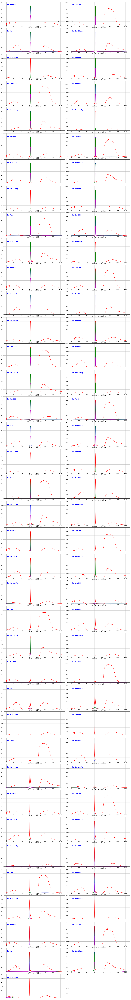

In [98]:
ShowLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)

In [99]:
import math as m
from matplotlib.backends.backend_pdf import PdfPages
def ShowFullLongitBackground(spectra,spectraUp,spectraDown,spectraAv,all_titles,object_name,NBIMGPERROW,dir_top_images):
    """
    Show the background to be removed to the spectrum
    
    Implemented to write in a pdf file
    
    """
    NBSPEC=len(spectra)
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    
    # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Longitudinal background Up/Down'.format(object_name)
    
    
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    for index in np.arange(0,NBSPEC):
        
        
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        # plot what is wanted
        axarr[iy,ix].plot(spectra[index],'r-')
        axarr[iy,ix].plot(spectraUp[index],'b-')
        axarr[iy,ix].plot(spectraDown[index],'g-')
        axarr[iy,ix].plot(spectraAv[index],'m-')
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
        
        star_pos=np.where(spectra[index][:spec_index_max]==spectra[index][:spec_index_max].max())[0][0]
        max_y_to_plot=(spectra[index][star_pos+star_halfwidth:spec_index_max]).max()*1.2
        
        
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        axarr[iy,ix].text(spec_index_min,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='center',color='blue',fontweight='bold', fontsize=20)
        
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
        
        
    
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()

/Users/dagoret/anaconda/lib/python2.7/site-packages/matplotlib/figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


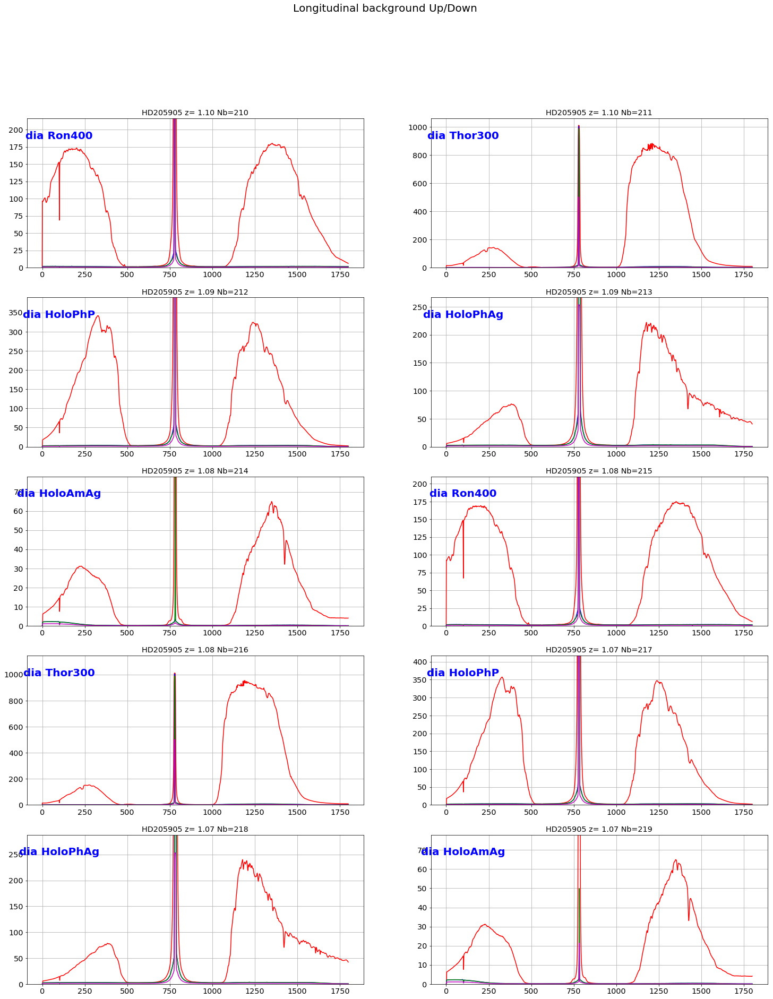

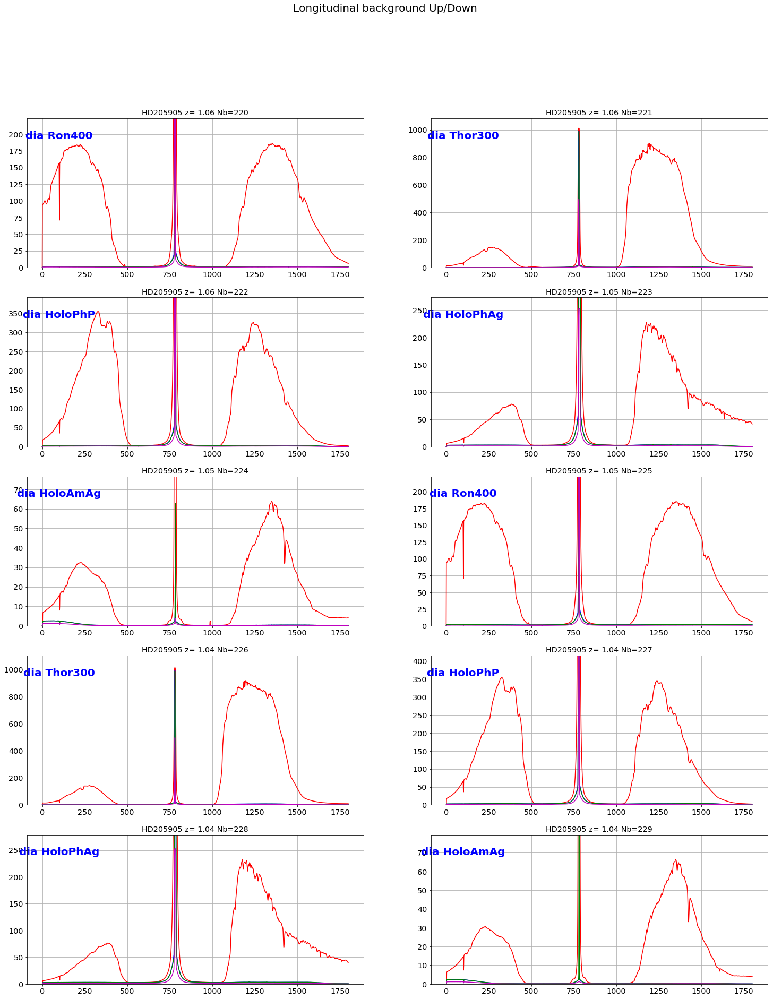

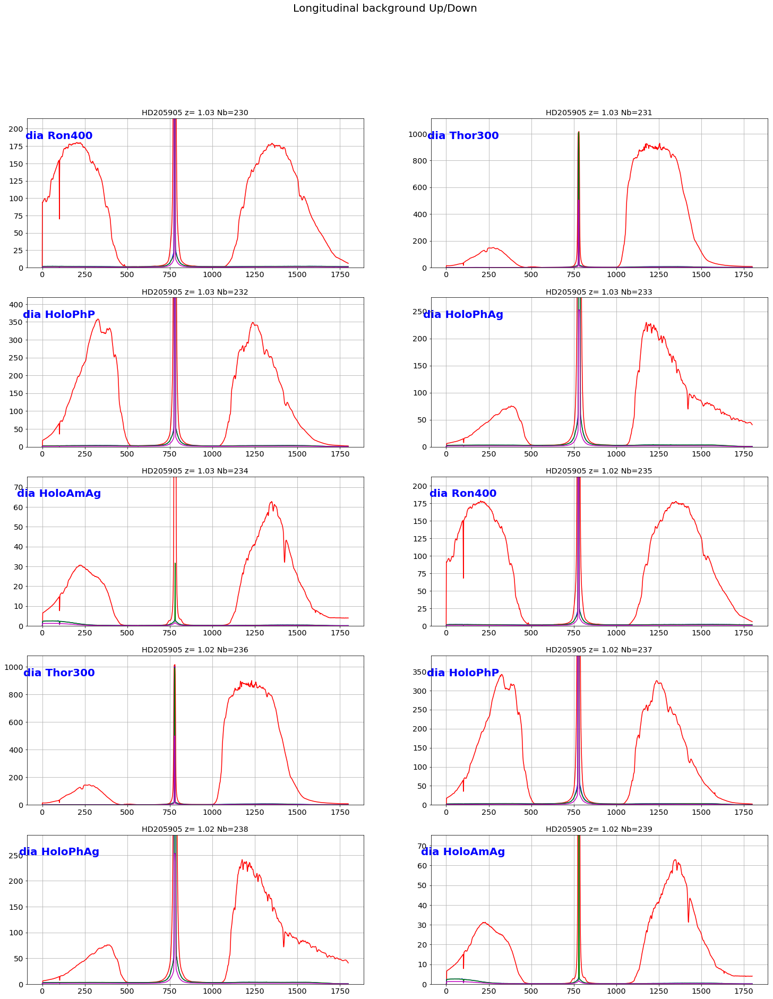

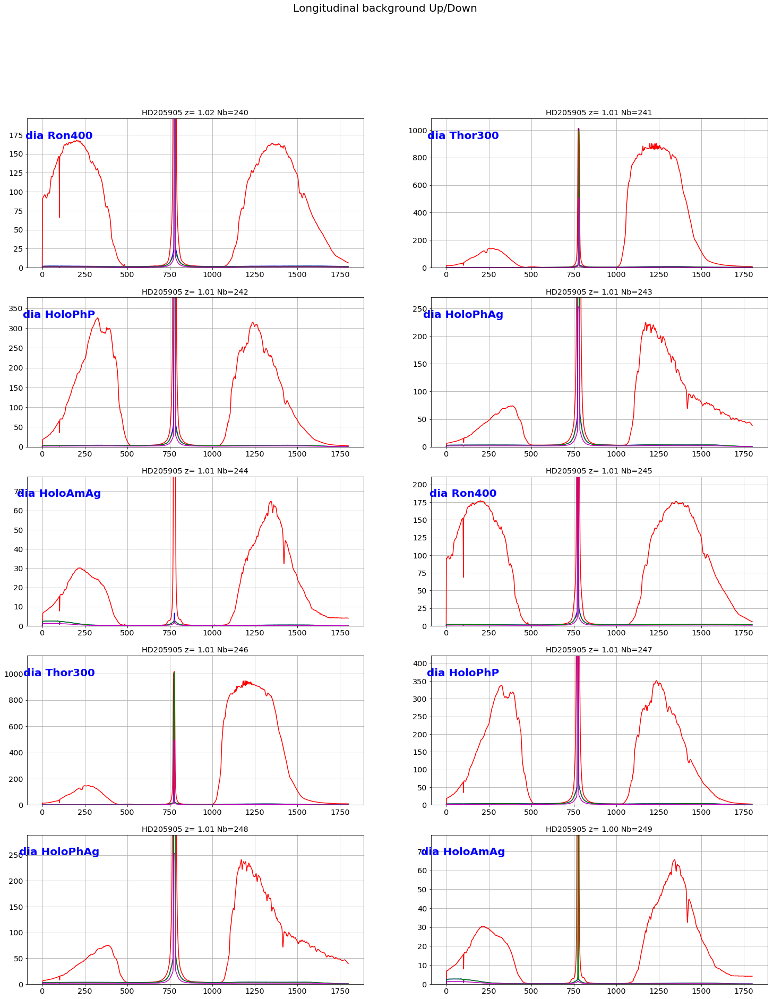

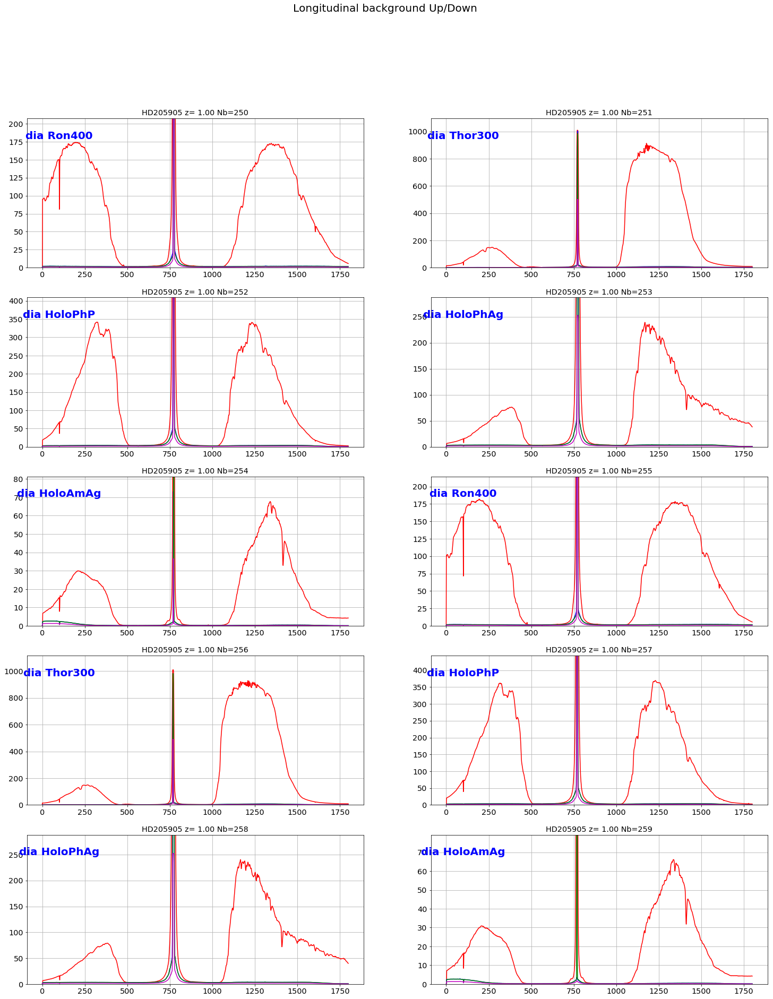

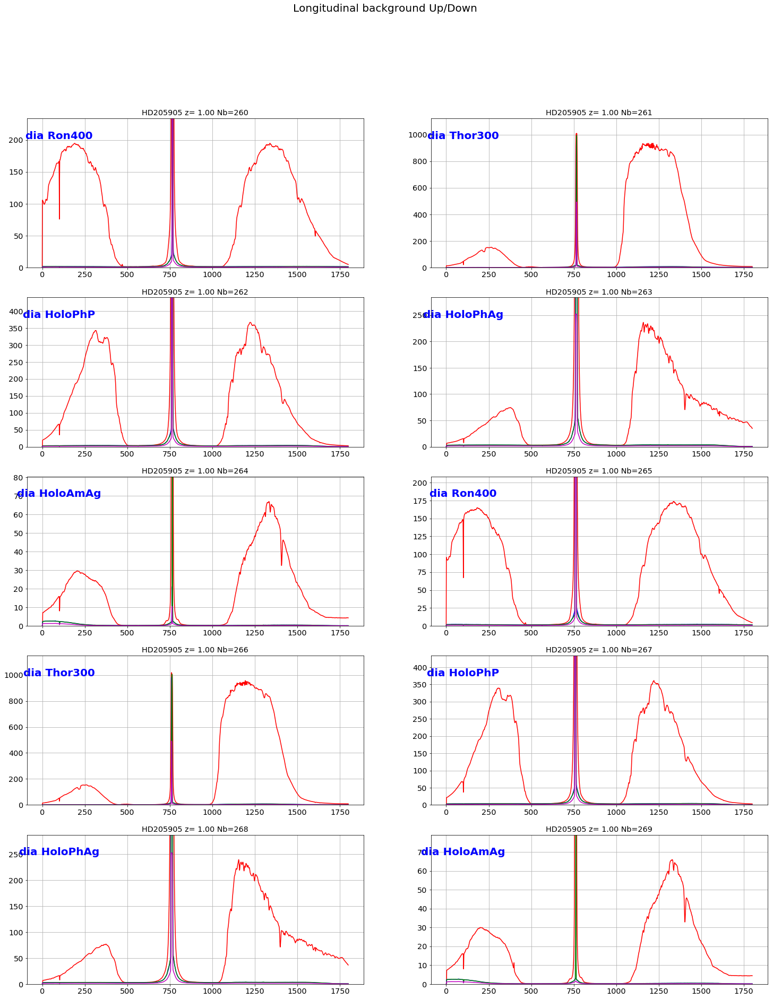

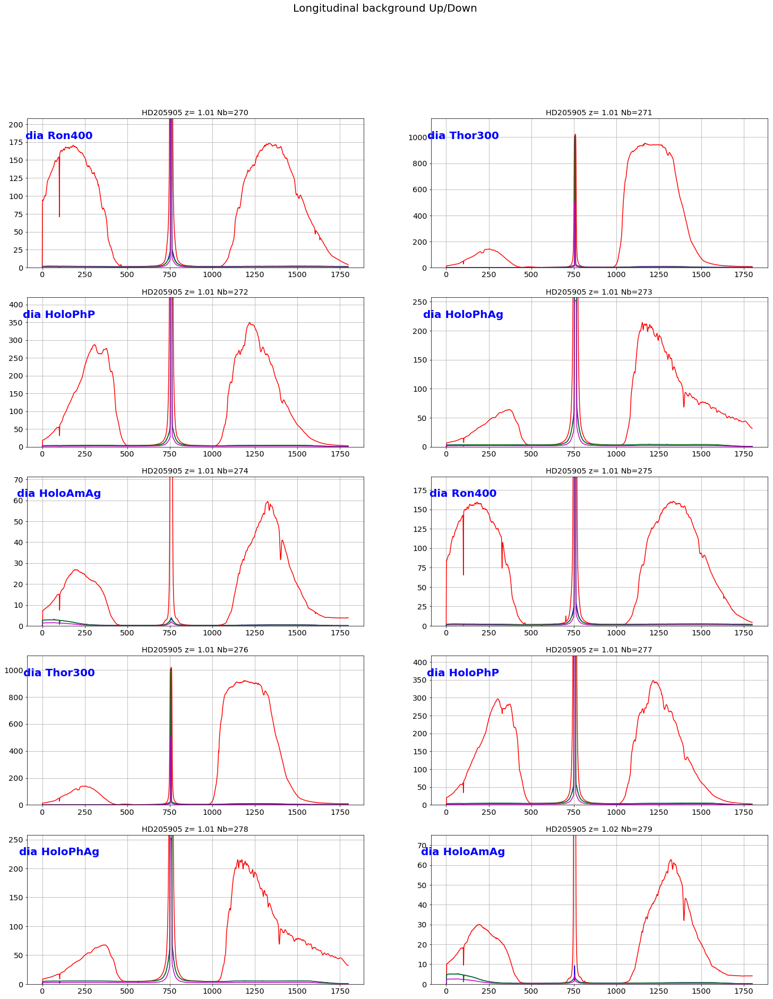

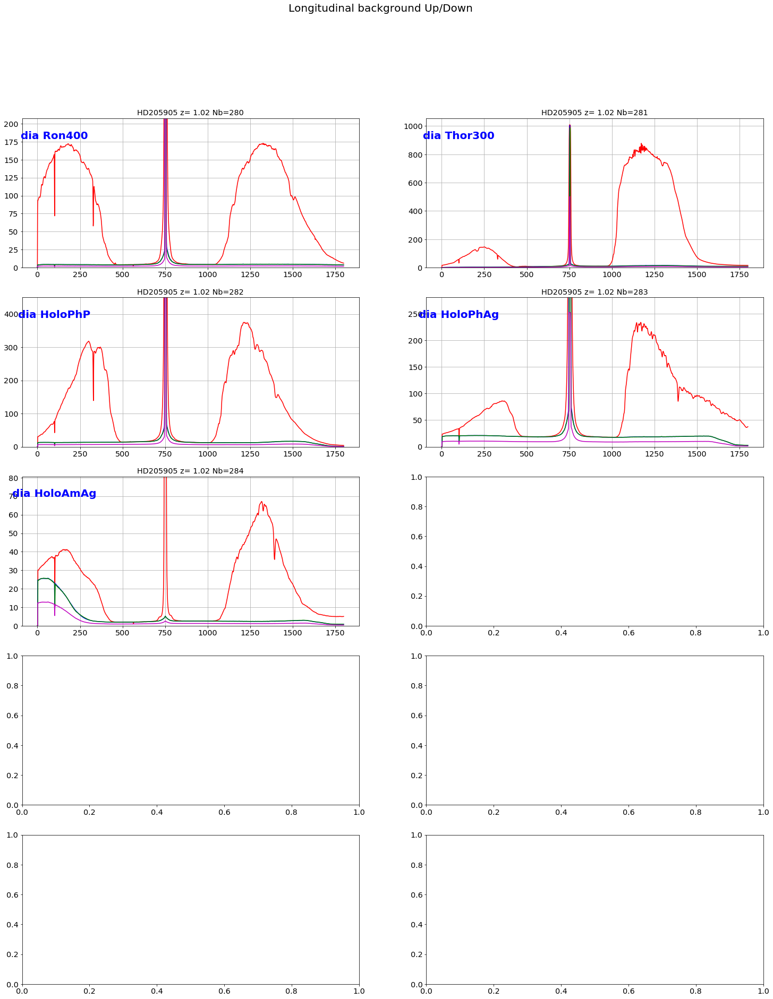

In [100]:
ShowFullLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,object_name,2,dir_top_images)

## If OK apply background subtraction

In [101]:
Clean_Up, Clean_Do,Clean_Av=CleanBadPixels(thespectraUp,thespectraDown) 

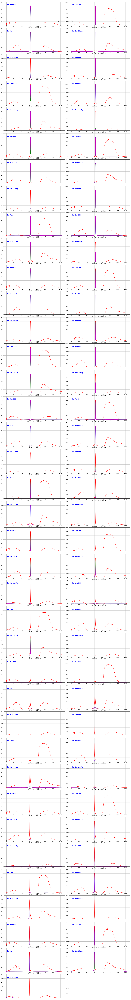

In [102]:
ShowLongitBackground(thespectra,Clean_Up,Clean_Do,Clean_Av,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)
figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
plt.savefig(figfilename)   

(0, 100.0)

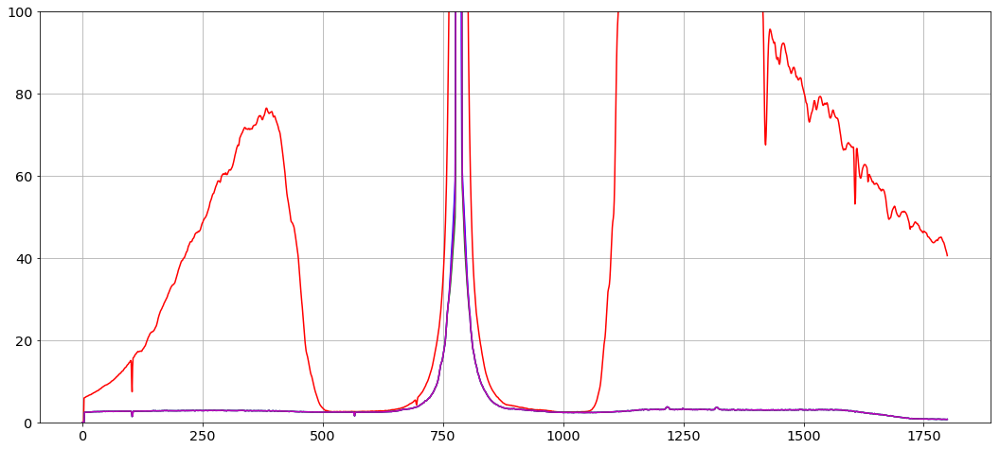

In [103]:
sel=3
plt.figure(figsize=(18,8))
plt.plot(thespectra[sel],'r-') 
plt.plot(Clean_Up[sel],'b-') 
plt.plot(Clean_Do[sel],'g-')
plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,100.)

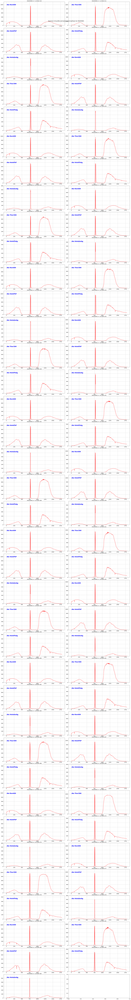

In [104]:
thecorrspectra=CorrectSpectrumFromBackground(thespectra,Clean_Av)

ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2)
figfilename=os.path.join(dir_top_images,'correctedspectrum_profile.pdf')
plt.savefig(figfilename) 

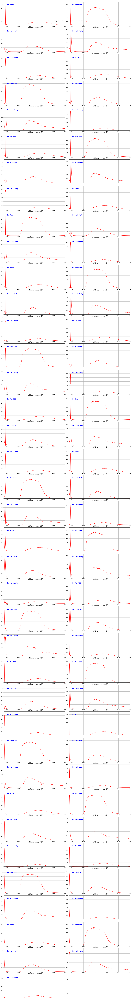

In [105]:
ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2,xlim=(750,1800))
figfilename=os.path.join(dir_top_images,'correctedspectrum_rightprofile.pdf')
plt.savefig(figfilename) 


## The real extraction will be done in another notebook

At this stage the work of extraction and rotation seems very good
